# Import necessary packages

In [1]:
import pandas as pd
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
import numpy as np
import warnings
warnings.filterwarnings("ignore")
from sklearn.preprocessing import LabelEncoder, MinMaxScaler, StandardScaler,MaxAbsScaler, RobustScaler, QuantileTransformer, PowerTransformer
from sklearn.linear_model import ElasticNet, enet_path
from sklearn.linear_model import ElasticNetCV

from scipy.spatial.distance import mahalanobis
import seaborn as sns
import matplotlib.pyplot as plt

import plotly.express as px
from plotly.subplots import make_subplots

import base64
from io import BytesIO

import plotly.graph_objects as go

# load dataset

In [2]:
unsw_data=pd.read_csv("UNSW_NB15_testing-set.csv")


# Data Preprocessing

In [3]:
unsw_data=unsw_data.drop(['id','dur'],axis=1)

In [4]:
unsw_data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 175341 entries, 0 to 175340
Data columns (total 43 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   proto              175341 non-null  object 
 1   service            175341 non-null  object 
 2   state              175341 non-null  object 
 3   spkts              175341 non-null  int64  
 4   dpkts              175341 non-null  int64  
 5   sbytes             175341 non-null  int64  
 6   dbytes             175341 non-null  int64  
 7   rate               175341 non-null  float64
 8   sttl               175341 non-null  int64  
 9   dttl               175341 non-null  int64  
 10  sload              175341 non-null  float64
 11  dload              175341 non-null  float64
 12  sloss              175341 non-null  int64  
 13  dloss              175341 non-null  int64  
 14  sinpkt             175341 non-null  float64
 15  dinpkt             175341 non-null  float64
 16  sj

In [5]:
label_encoder = LabelEncoder()
 
# 'proto', 'service', and 'state' are object types so convert them to numeric by encoding
object_types = ['proto', 'service', 'state']
for col in object_types:
    unsw_data[col] = label_encoder.fit_transform(unsw_data[col])


# generate heatmaps for data after applying  different scalars and original data 

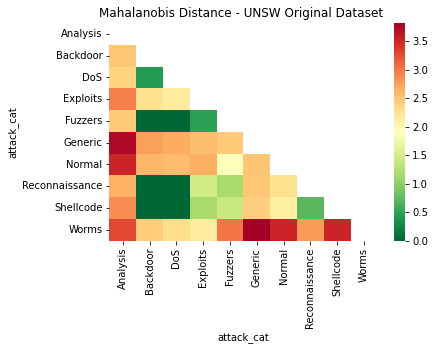

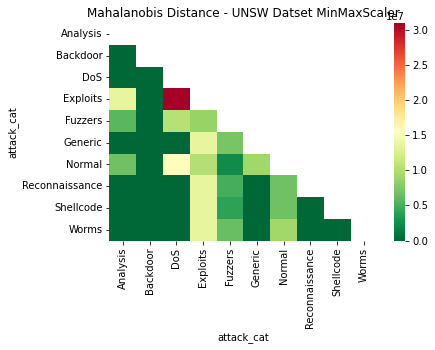

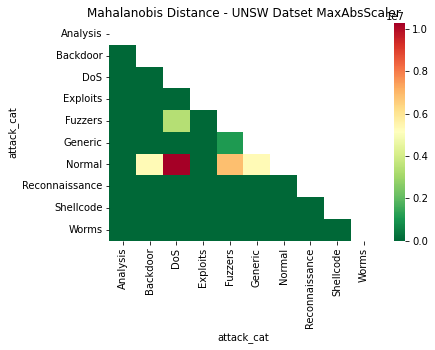

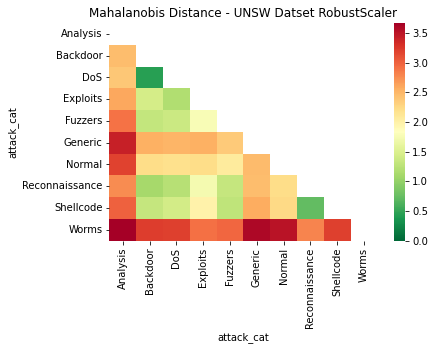

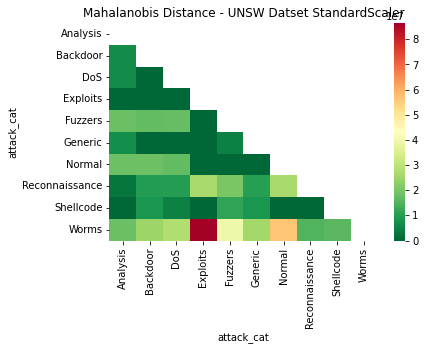

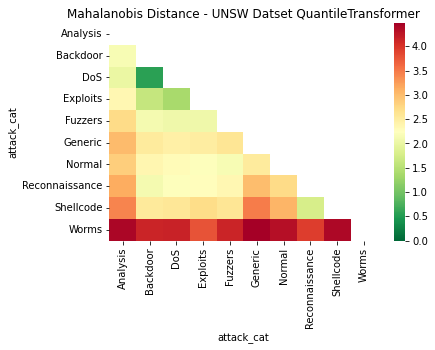

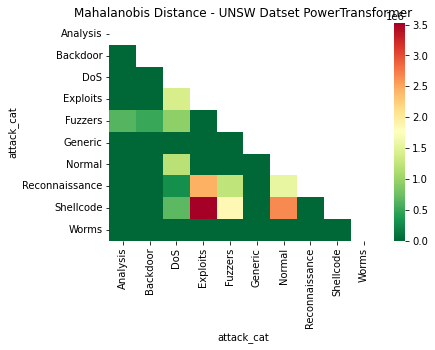

In [6]:

# Load your dataset
data = unsw_data

# Define a function to calculate the Mahalanobis distance matrix for a given DataFrame
def distance_matrix(data, column):
    # Calculate the inverse of the covariance matrix
    inverted_cov_matrix = np.linalg.inv(data.cov())

    # Calculate the centroids of each class
    centroids = data.groupby(column).mean()

    # Calculate the Mahalanobis distance between each pair of centroids
    mahalanobis_distances = pd.DataFrame(index=centroids.index, columns=centroids.index)

    for i in centroids.index:
        for j in centroids.index:
            mahalanobis_distances.loc[i, j] = mahalanobis(centroids.loc[i], centroids.loc[j], inverted_cov_matrix)

    return mahalanobis_distances.astype(float)

# Calculate and plot the Mahalanobis distance matrix for the original dataset
original_matrix = distance_matrix(data.drop('attack_cat', axis=1), data['attack_cat'])
mask_upper = np.triu(np.ones_like(original_matrix, dtype=bool))

# Plot the heatmap with the mask
original_matrix = original_matrix.fillna(0)
sns.heatmap(original_matrix, cmap='RdYlGn_r', mask=mask_upper,vmin=0,vmax=original_matrix.max().max())
plt.title('Mahalanobis Distance - UNSW Original Dataset ')
plt.show()

# List of scalars to be applied
scalars = [MinMaxScaler(), MaxAbsScaler(), RobustScaler(), StandardScaler(), QuantileTransformer(), PowerTransformer()]
scalar_names = ['MinMaxScaler', 'MaxAbsScaler', 'RobustScaler', 'StandardScaler', 'QuantileTransformer', 'PowerTransformer']

# Apply each scaler, calculate Mahalanobis distance matrix, and plot heatmap
for scalar, name in zip(scalars, scalar_names):
    scaled_attributes = scalar.fit_transform(data.drop(['attack_cat'], axis=1))
    scaled_data = pd.DataFrame(scaled_attributes, columns=data.columns[:-1])
    scaled_data['attack_cat'] = data['attack_cat'].values  # Add the class label back

    mahalanobis_for_scaled = distance_matrix(scaled_data.drop('attack_cat', axis=1), scaled_data['attack_cat'])
    scaled_matrix = mahalanobis_for_scaled.fillna(0)
    sns.heatmap(scaled_matrix, cmap='RdYlGn_r', mask=mask_upper, vmin=0, vmax=scaled_matrix.max().max())
    plt.title(f'Mahalanobis Distance - UNSW Datset {name}')
    plt.show()


# Interactive plot of heatmaps

In [7]:


# Load your dataset
data = unsw_data

# Mask upper triangle for the ladder shape
def mask_upper_triangle(matrix):
    mask = np.triu(np.ones_like(matrix, dtype=bool))
    matrix_masked = matrix.where(~mask, None)  # Set upper triangle to None
    return matrix_masked

# Calculate the Mahalanobis distance matrix for the original dataset and mask it



original_matrix_masked = mask_upper_triangle(original_matrix)
class_labels=original_matrix.columns.tolist()

# Create a subplot with 1 row and 7 columns
fig = make_subplots(rows=1, cols=7, subplot_titles=('Original', 'MinMaxScaler', 'MaxAbsScaler', 'RobustScaler', 'StandardScaler', 'QuantileTransformer', 'PowerTransformer'))

# Plot the interactive heatmap for the original dataset
fig.add_trace(
    go.Heatmap(x=class_labels,y=class_labels,z=original_matrix_masked.to_numpy(), colorscale='RdYlGn_r',showscale=True),
    row=1, col=1
)

# Counter for subplot columns
plot_count = 2

# Apply each scaler, calculate Mahalanobis distance matrix, mask it, and plot interactive heatmap
for scalar, name in zip(scalars, scalar_names):
    scaled_attributes = scalar.fit_transform(data.drop(['attack_cat'], axis=1))
    scaled_data = pd.DataFrame(scaled_attributes, index=data.index, columns=data.columns[:-1])
    scaled_data['attack_cat'] = data['attack_cat'].values  # Add the class label back

    mahalanobis_scaled = distance_matrix(scaled_data.drop('attack_cat', axis=1), scaled_data['attack_cat'])
    mahalanobis_scaled=mahalanobis_scaled.fillna(0)
    mahalanobis_masked = mask_upper_triangle(mahalanobis_scaled)

    # Plot the interactive heatmap
    filled_matrix = mahalanobis_scaled.fillna(9999)
    fig.add_trace(
        go.Heatmap(x=class_labels,y=class_labels,z=mahalanobis_masked.to_numpy(),colorscale='RdYlGn_r',showscale=True),
        row=1, col=plot_count
    )
 
    fig.update_traces(zmin=mahalanobis_masked.min().min(), zmax=mahalanobis_masked.max().max(), selector=dict(type='heatmap', col=plot_count))

    plot_count += 1


fig.update_layout(height=600, width=4200, title_text="UNSW DataSet Mahalanobis Distance Comparisons")
fig.update_yaxes(autorange="reversed")


# Save to an HTML file
fig.write_html(r"unsw_outputs/HeatMaps_unsw.html")

fig.show()

# apply minmax scalar before elastic net

In [8]:
data = unsw_data
scalar=MinMaxScaler()
scaled_data = scalar.fit_transform(data.drop(['attack_cat'], axis=1))
scaled_data = pd.DataFrame(scaled_data, index=data.index, columns=data.columns[:-1])
scaled_data['attack_cat'] = data['attack_cat'].values  # Add the class label back

# elastic net 

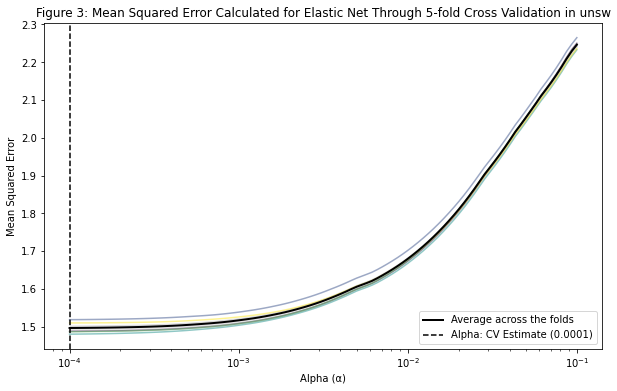

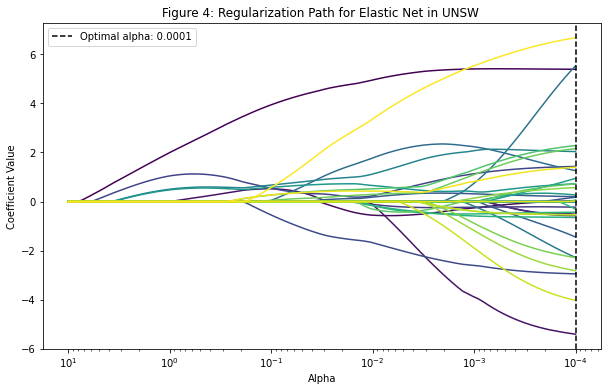

In [9]:
import matplotlib.pyplot as plt
import base64
from io import BytesIO
from sklearn.linear_model import ElasticNetCV
from sklearn.model_selection import train_test_split
import matplotlib.cm as cm

label_encoder = LabelEncoder()

# label enocde attack_cat
scaled_data['attack_cat'] = label_encoder.fit_transform(scaled_data['attack_cat'])
# Assuming scaled_data is your DataFrame after Min-Max scaling and 'attack_cat' is the target variable
X = scaled_data.drop('attack_cat', axis=1).values  # features
y = scaled_data['attack_cat'].values  # target

# Split the dataset into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define the ElasticNetCV model
elastic_net_cv = ElasticNetCV(l1_ratio=0.5, alphas=np.logspace(-4, -1, 100), cv=5, random_state=42)

# Fit the model
elastic_net_cv.fit(X_train, y_train)

# ... Your existing setup code for ElasticNetCV and fitting the model ...

# Plot the MSE path (Figure 3)
mse_path = elastic_net_cv.mse_path_
avg_mse = np.mean(mse_path, axis=1)
sem_mse = np.std(mse_path, axis=1) / np.sqrt(elastic_net_cv.cv)
colors = plt.cm.viridis(np.linspace(0, 1, mse_path.shape[1]))


plt.figure(figsize=(10, 6))
for i in range(mse_path.shape[1]):
    plt.plot(elastic_net_cv.alphas_, mse_path[:, i], linestyle='-', color=colors[i], alpha=0.5)

# Plot the average MSE across the folds with standard error
plt.plot(elastic_net_cv.alphas_, avg_mse, label='Average across the folds', linewidth=2, color='black')
plt.fill_between(elastic_net_cv.alphas_, avg_mse - sem_mse, avg_mse + sem_mse, color='grey', alpha=0.2)

# Highlight the selected alpha with a dashed line
plt.axvline(elastic_net_cv.alpha_, linestyle='--', color='black', label=f'Alpha: CV Estimate ({elastic_net_cv.alpha_:.4f})')

# Additional settings for the plot
plt.xscale('log')
plt.xlabel('Alpha (α)')
plt.ylabel('Mean Squared Error')
plt.title('Figure 3: Mean Squared Error Calculated for Elastic Net Through 5-fold Cross Validation in unsw')

plt.legend()
plt.savefig(r"unsw_outputs/elasticnet_mse_unsw.png")
plt.show()




from sklearn.linear_model import enet_path

# Generate the alpha values for which we want to compute the regularization path
# This should ideally cover the range of alphas you're interested in
alphas = np.logspace(-4, 1, 100)

# Compute the paths using the enet_path function
# Replace X_train and y_train with your actual data
alphas, coefs, _ = enet_path(X_train, y_train, l1_ratio=0.5, alphas=alphas)

# Plot the regularization paths
plt.figure(figsize=(10, 6))

# Create a colormap
colors = plt.cm.viridis(np.linspace(0, 1, coefs.shape[0]))

# Plot each coefficient's path
for i in range(coefs.shape[0]):
    plt.plot(alphas, coefs[i, :], linestyle='-', color=colors[i])

# Mark the optimal alpha value
  # Replace with your actual optimal alpha value
plt.axvline(elastic_net_cv.alpha_, linestyle='--', color='black', label=f'Optimal alpha: {elastic_net_cv.alpha_}')

# Set the x-axis to a logarithmic scale
plt.xscale('log')

# Invert the x-axis to display the larger alphas (stronger regularization) on the left
plt.gca().invert_xaxis()

# Label the axes and add a title
plt.xlabel('Alpha')
plt.ylabel('Coefficient Value')
plt.title('Figure 4: Regularization Path for Elastic Net in UNSW ')

# Add a legend
plt.legend()

# Show the plot

plt.show()



# optimal alpha

In [10]:
elastic_net_cv.alpha_

0.0001

# regularization path for top 24 elastic net features

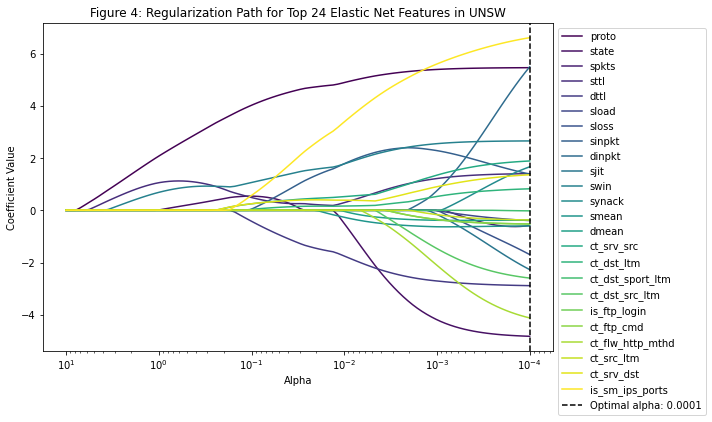

In [11]:
# Assuming that optimal_alpha and l1_ratio have already been determined
optimal_alpha = elastic_net_cv.alpha_
#l1_ratio = 0.5  # or the value you want

# Fit the Elastic Net model using the optimal alpha
enet = ElasticNet(alpha=optimal_alpha, l1_ratio=0.5, fit_intercept=True)
enet.fit(X_train, y_train)

# Get the coefficients and feature names
coefficients = enet.coef_
feature_names = scaled_data.drop('attack_cat', axis=1).columns

# Create a Series to hold feature names and their corresponding coefficients
feature_importance = pd.Series(coefficients, index=feature_names)

# Sort the features by the absolute values of their coefficients in descending order
sorted_features = feature_importance.abs().sort_values(ascending=False)

# Select the top 24 features
top_24_features = sorted_features.head(24).index


# Refit the Elastic Net model using only these features
X_train_top_24 = X_train[:, feature_names.isin(top_24_features)]
X_train_top_24_names = feature_names[feature_names.isin(top_24_features)]

# Calculate the path for the Elastic Net using only the selected features
alphas, coefs,_=enet_path(X_train_top_24, y_train, l1_ratio=0.5,alphas=np.logspace(-4, 1, 100))

# Plot the regularization paths for the top features
plt.figure(figsize=(10, 6))
colors = plt.cm.viridis(np.linspace(0, 1, len(top_24_features)))

for i, coef in enumerate(coefs):
    plt.plot(alphas, coef, label=X_train_top_24_names[i], color=colors[i])

# Mark the optimal alpha value
plt.axvline(optimal_alpha, linestyle='--', color='black', label=f'Optimal alpha: {optimal_alpha}')

# Set the x-axis to a logarithmic scale and invert it
plt.xscale('log')
plt.gca().invert_xaxis()

# Label the axes and add a title
plt.xlabel('Alpha')
plt.ylabel('Coefficient Value')
plt.title('Figure 4: Regularization Path for Top 24 Elastic Net Features in UNSW')

# Add a legend
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.tight_layout()
plt.savefig(r"unsw_outputs\elasticnet2_unsw.png")
plt.show()



# selecting top features based on elastic net results

In [12]:
selected_features=list(X_train_top_24_names)

selected_features.append('attack_cat')
unsw_data=unsw_data[selected_features]

In [13]:
unsw_data

,proto,state,spkts,sttl,dttl,sload,sloss,sinpkt,dinpkt,sjit,swin,synack,smean,dmean,ct_srv_src,ct_dst_ltm,ct_dst_sport_ltm,ct_dst_src_ltm,is_ftp_login,ct_ftp_cmd,ct_flw_http_mthd,ct_src_ltm,ct_srv_dst,is_sm_ips_ports,attack_cat
0,113,2,6,252,254,1.415894e+04,0,24.295600,8.375000,30.177547,255,0.000000,43,43,1,1,1,1,0,0,0,1,1,0,Normal
1,113,2,14,62,252,8.395112e+03,2,49.915000,15.432865,61.426934,255,0.000000,52,1106,43,1,1,2,0,0,0,1,6,0,Normal
2,113,2,8,62,252,1.572272e+03,1,231.875571,102.737203,17179.586860,255,0.061458,46,824,7,2,1,3,0,0,0,2,6,0,Normal
3,113,2,12,62,252,2.740179e+03,1,152.876547,90.235726,259.080172,255,0.000000,52,64,1,2,1,3,1,1,0,2,1,0,Normal
4,113,2,10,254,252,8.561499e+03,2,47.750333,75.659602,2415.837634,255,0.071147,53,45,43,2,1,40,0,0,0,2,39,0,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175336,119,3,2,254,0,5.066666e+07,0,0.009000,0.000000,0.000000,0,0.000000,57,0,24,24,13,24,0,0,0,24,24,0,Generic
175337,113,2,10,254,252,8.826286e+03,2,54.400111,66.980570,3721.068786,255,0.036895,62,44,1,1,1,2,0,0,0,1,1,0,Shellcode
175338,119,3,2,254,0,5.066666e+07,0,0.009000,0.000000,0.000000,0,0.000000,57,0,12,3,3,13,0,0,0,3,12,0,Generic
175339,119,3,2,254,0,5.066666e+07,0,0.009000,0.000000,0.000000,0,0.000000,57,0,30,30,14,30,0,0,0,30,30,0,Generic


In [14]:
# Make sure that scaled_df is your original DataFrame with the 'attack_cat' column

# Group the data by 'attack_cat' and sample 25% from each group
sampled_data = unsw_data.groupby('attack_cat', group_keys=False).apply(lambda x: x.sample(frac=0.25))
sampled_data=sampled_data.copy()
sampled_data1=sampled_data.copy()
# Check the new distribution
print(sampled_data['attack_cat'].value_counts(normalize=True))

# Check the length of the new dataset
print(f"Length of the sampled dataset: {len(sampled_data)}")


Normal            0.319387
Generic           0.228133
Exploits          0.190446
Fuzzers           0.103709
DoS               0.069946
Reconnaissance    0.059839
Analysis          0.011407
Backdoor          0.009947
Shellcode         0.006456
Worms             0.000730
Name: attack_cat, dtype: float64
Length of the sampled dataset: 43834


# count each class in attack_cat in unsw dataset

In [15]:
import plotly.express as px

# Assuming 'viz_df' is the DataFrame and 'attack_cat' is the target variable with encoded classes
count_class = sampled_data['attack_cat'].value_counts().reset_index()
count_class.columns = ['Class', 'Count']

# Create an interactive bar plot
fig = px.bar(count_class, x='Class', y='Count', text='Count',
             title='Count of Each Class in attack_cat in unsw dataset',color_discrete_sequence=px.colors.qualitative.Vivid)
fig.update_traces(texttemplate='%{text}', textposition='outside')

fig.write_html(r"unsw_outputs\bargraph_unsw.html")
fig.show()

# TSNE Visualisation

In [16]:

from sklearn.manifold import TSNE
import plotly.express as px


# Perform t-SNE dimensionality reduction
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(sampled_data.drop('attack_cat', axis=1))

# Integrate the t-SNE results into the original DataFrame
sampled_data['tsne-one'] = tsne_results[:, 0]
sampled_data['tsne-two'] = tsne_results[:, 1]

# Create an interactive scatter plot
fig = px.scatter(sampled_data, x='tsne-one', y='tsne-two', color='attack_cat',
                 title='t-SNE visualization of the UNSW dataset', color_discrete_sequence=px.colors.qualitative.Vivid,
                 labels={'attack_cat': 'Attack Category'})

# Adjust the layout
fig.update_layout(
    margin=dict(l=0, r=0, b=0, t=30),
    hovermode='closest'
)

# Show the plot

fig.write_html(r"unsw_outputs\tsne_unsw.html")
fig.show()

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 43834 samples in 0.001s...
[t-SNE] Computed neighbors for 43834 samples in 80.074s...
[t-SNE] Computed conditional probabilities for sample 1000 / 43834
[t-SNE] Computed conditional probabilities for sample 2000 / 43834
[t-SNE] Computed conditional probabilities for sample 3000 / 43834
[t-SNE] Computed conditional probabilities for sample 4000 / 43834
[t-SNE] Computed conditional probabilities for sample 5000 / 43834
[t-SNE] Computed conditional probabilities for sample 6000 / 43834
[t-SNE] Computed conditional probabilities for sample 7000 / 43834
[t-SNE] Computed conditional probabilities for sample 8000 / 43834
[t-SNE] Computed conditional probabilities for sample 9000 / 43834
[t-SNE] Computed conditional probabilities for sample 10000 / 43834
[t-SNE] Computed conditional probabilities for sample 11000 / 43834
[t-SNE] Computed conditional probabilities for sample 12000 / 43834
[t-SNE] Computed conditional probabilities for s

# Principal Component Analysis 3D visualisation

In [17]:
from sklearn.decomposition import PCA
# Assuming 'viz_df' is your DataFrame and 'attack_cat' is the categorical column with labels
# Ensure that attack_cat is included and properly encoded if needed.

# Perform PCA for dimensionality reduction to 3 components
pca = PCA(n_components=3)
pca_transformed= pca.fit_transform(sampled_data.drop('attack_cat', axis=1))

# Integrate the PCA results into the original DataFrame
sampled_data['pca-one'] = pca_transformed[:, 0]
sampled_data['pca-two'] = pca_transformed[:, 1]
sampled_data['pca-three'] = pca_transformed[:, 2]

# Create an interactive 3D scatter plot using Plotly
fig = px.scatter_3d(sampled_data, x='pca-one', y='pca-two', z='pca-three',
                    color='attack_cat', labels={'attack_cat': 'Attack Category'},
                    title='3D PCA Visualization of the UNSW Dataset',
                    color_discrete_map = {'Normal': 'lightblue', 'Backdoor': 'olive', 'Analysis': 'teal',
                      'Fuzzers': 'coral', 'Shellcode': 'lime', 'Reconnaissance': 'navy',
                      'Exploits': 'fuchsia', 'DoS': 'gold', 'Worms': 'sienna', 'Generic': 'slategray'})

# Update the layout to make points semi-transparent for better visibility
fig.update_traces(marker=dict(size=5, opacity=0.7))

# Show the plot

fig.write_html(r"unsw_outputs\pca3d_unsw.html")
fig.show()

# PCA 2D PLOTS FOR NORMAL-FUZZER AND NORMAL-EXPLOITS

In [18]:


# Filter the dataset for "Normal" and "Exploit" classes
exploit_normal_data = sampled_data1[sampled_data1['attack_cat'].isin(['Normal', 'Exploits'])]

# Perform PCA for 2 components on the filtered dataset
pca1 = PCA(n_components=2)
pca_results1 = pca1.fit_transform(exploit_normal_data.drop('attack_cat', axis=1))

# Create a DataFrame for the PCA results
pca_data1 = pd.DataFrame(data=pca_results1, columns=['pca-one', 'pca-two'])
pca_data1['attack_cat'] = exploit_normal_data['attack_cat'].values
discrete_color_map_en = {'Normal': 'blue', 'Exploits': 'red'}
# Create an interactive 2D scatter plot for "Normal" and "Exploit" classes
fig1 = px.scatter(pca_data1, x='pca-one', y='pca-two', color='attack_cat', color_discrete_map=discrete_color_map_en,
                    title='2D PCA Visualization - Normal and Exploit Classes in UNSW dataset')
fig1.update_traces(marker=dict(size=8, opacity=0.8))
#fig_ne.update_layout( plot_bgcolor='lightblue')
fig1.show()
fig1.write_html(r"unsw_outputs/NEplot_unsw.html")
# Filter the dataset for "Normal" and "Fuzzer" classes
normal_fuzzer_data = sampled_data1[sampled_data1['attack_cat'].isin(['Normal', 'Fuzzers'])]

# Perform PCA for 2 components on the filtered dataset
pca2= PCA(n_components=2)
pca_result2 = pca2.fit_transform(normal_fuzzer_data.drop('attack_cat', axis=1))

# Create a DataFrame for the PCA results
pca_nf_data = pd.DataFrame(data=pca_result2, columns=['pca-one', 'pca-two'])
pca_nf_data['attack_cat'] = normal_fuzzer_data['attack_cat'].values
discrete_color_map_nf = {'Normal': 'green', 'Fuzzers': 'purple'}
# Create an interactive 2D scatter plot for "Normal" and "Fuzzer" classes
fig2 = px.scatter(pca_nf_data, x='pca-one', y='pca-two', color='attack_cat', color_discrete_map=discrete_color_map_nf,
                    title='2D PCA Visualization - Normal and Fuzzer Classes in UNSW dataset')
fig2.update_traces(marker=dict(size=8, opacity=0.8))


fig2.write_html(r"unsw_outputs\Nfplot_unsw.html")

fig2.show()

# Linear discriminant analysis

In [19]:
import plotly.express as px
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

# Assuming 'viz_df' is your DataFrame and 'attack_cat' is the categorical column with labels
# Ensure that 'attack_cat' is included and properly encoded if needed.

# Perform LDA for dimensionality reduction to 3 components
lda = LinearDiscriminantAnalysis(n_components=3)
lda_result = lda.fit_transform(sampled_data1.drop('attack_cat', axis=1), sampled_data1['attack_cat'])

# Integrate the LDA results into the original DataFrame
sampled_data['lda-one'] = lda_result[:, 0]
sampled_data['lda-two'] = lda_result[:, 1]
sampled_data['lda-three'] = lda_result[:, 2]

# Create an interactive 3D scatter plot using Plotly
fig = px.scatter_3d(sampled_data, x='lda-one', y='lda-two', z='lda-three',
                    color='attack_cat', labels={'attack_cat': 'Attack Category'},
                    title='3D LDA Visualization of the UNSW Dataset',
                    color_discrete_map={'Normal': 'lightblue', 'Backdoor': 'olive', 'Analysis': 'teal',
                                        'Fuzzers': 'coral', 'Shellcode': 'lime', 'Reconnaissance': 'navy',
                                        'Exploits': 'fuchsia', 'DoS': 'gold', 'Worms': 'sienna', 'Generic': 'slategray'})

# Update the layout to make points semi-transparent for better visibility
fig.update_traces(marker=dict(size=5, opacity=0.7))

# Show the plot

fig.write_html(r"unsw_outputs\lda3d_unsw.html")
fig.show()

# plot of kmeans with shrunken centroids for unsw dataset

In [20]:
import plotly.graph_objects as go
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import numpy as np

# Assuming 'viz_df' is the DataFrame with the 'attack_cat' column after label encoding
# and all other columns are the features.
sampled_data2=sampled_data1.copy()
# Perform standard scaling on features for PCA
features = sampled_data2.drop('attack_cat', axis=1)
#print(features)
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

# Perform PCA for dimensionality reduction to 2 components for visualization
pca = PCA(n_components=2)
features_reduced = pca.fit_transform(features_scaled)

# Compute the centroids and the count for each class
class_centroids = sampled_data2.groupby('attack_cat').mean()
class_sizes = sampled_data2['attack_cat'].value_counts()

# Shrink the centroids towards the overall mean
delta = 0.5  # Shrinkage parameter
overall_mean = features.mean().values
shrunken_centroids = class_centroids.apply(lambda x: (1 - delta) * x + delta * overall_mean, axis=1)

# Reduce the dimensionality of the shrunken centroids for visualization
centroids_reduced = pca.transform(shrunken_centroids)

# Create an interactive plot with Plotly
fig = go.Figure()

# Define a minimum size for the smallest circle to ensure visibility
min_size = 10

# Adjust the scaling factor for the size to reflect the square root of the count
scaling_factor = 100 / np.sqrt(class_sizes.max())

for i, (centroid, count) in enumerate(zip(centroids_reduced, class_sizes)):
    class_name = class_centroids.index[i]
    # Ensure even the smallest class has a visible circle, use square root scaling for area representation
    size = np.sqrt(count) * scaling_factor
    size = max(size, min_size)  # Apply the minimum size
    fig.add_trace(go.Scatter(
        x=[centroid[0]],
        y=[centroid[1]],
        marker=dict(
            size=size,
            opacity=0.5,
            line=dict(width=2),
        ),
        mode='markers+text',
        text=str(class_sizes.index[i]),  # Use the actual class names if available
        textposition='top center',
        name=f' {class_sizes.index[i]}'
    ))

# Update the layout of the plot
fig.update_layout(
    title='Plot of shrunken centroids with PCA for unsw dataset ',
    xaxis_title='First Principal Component',
    yaxis_title='Second Principal Component',
    legend_title='Attack Category',
    showlegend=True
)


fig.write_html(r"unsw_outputs\Kmeans_unsw.html")
fig.show()

# plot of kmeans with shrunken centroids for unsw dataset with LDA

In [21]:
import plotly.graph_objects as go
from sklearn.preprocessing import StandardScaler
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
import numpy as np

# Assuming 'viz_df' is the DataFrame with the 'attack_cat' column after label encoding
# and all other columns are the features.

# Perform standard scaling on features for LDA
features = sampled_data1.drop('attack_cat', axis=1)
labels = sampled_data1['attack_cat']
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

# Perform LDA for dimensionality reduction
lda = LinearDiscriminantAnalysis(n_components=2)  # Assuming there are more than 2 classes
features_reduced = lda.fit_transform(features_scaled, labels)

# Compute the centroids and the count for each class
class_centroids = sampled_data1.groupby('attack_cat').mean()
class_sizes = sampled_data1['attack_cat'].value_counts()

# Shrink the centroids towards the overall mean
delta = 0.5  # Shrinkage parameter
overall_mean = features.mean().values
shrunken_centroids = class_centroids.apply(lambda x: (1 - delta) * x + delta * overall_mean, axis=1)

# Reduce the dimensionality of the shrunken centroids for visualization
centroids_reduced = lda.transform(shrunken_centroids)

# Create an interactive plot with Plotly
fig = go.Figure()

# Define a minimum size for the smallest circle to ensure visibility
min_size = 10

# Adjust the scaling factor for the size to reflect the square root of the count
scaling_factor = 100 / np.sqrt(class_sizes.max())

for i, (centroid, count) in enumerate(zip(centroids_reduced, class_sizes)):
    class_name = class_centroids.index[i]
    # Ensure even the smallest class has a visible circle, use square root scaling for area representation
    size = np.sqrt(count) * scaling_factor
    size = max(size, min_size)  # Apply the minimum size
    fig.add_trace(go.Scatter(
        x=[centroid[0]],
        y=[centroid[1]],
        marker=dict(
            size=size,
            opacity=0.5,
            line=dict(width=2),
        ),
        mode='markers+text',
        text=str(class_sizes.index[i]),  # Use the actual class names if available
        textposition='top center',
        name=f' {class_sizes.index[i]}'
    ))

# Update the layout of the plot
fig.update_layout(
    title='Plot of Shrunken Centroids with LDA for unsw dataset',
    xaxis_title='First Linear Discriminant',
    yaxis_title='Second Linear Discriminant',
    legend_title='Attack Category',
    showlegend=True
)


# Save the plot to an HTML file
fig.write_html(r"unsw_outputs\LDA_Kmeans_unsw.html")
fig.show()

# Visualization with K-Modes Clustering for unsw dataset with PCA

In [22]:
from kmodes.kmodes import KModes
import plotly.graph_objects as go
from sklearn.decomposition import PCA
import numpy as np
import pandas as pd

# Assuming 'viz_df' is the DataFrame with the 'attack_cat' column and all other columns are the features.

# Choose the number of clusters to match the number of unique classes in 'attack_cat'
n_clusters = sampled_data['attack_cat'].nunique()

# Initialize the K-Modes algorithm
kmodes = KModes(n_clusters=n_clusters, init='Huang', n_init=5, verbose=1)

# Fit the K-Modes algorithm on the dataset
clusters = kmodes.fit_predict(sampled_data.drop('attack_cat', axis=1))

# Perform PCA for dimensionality reduction to 2 components for visualization
pca = PCA(n_components=2)
features_reduced = pca.fit_transform(sampled_data.drop('attack_cat', axis=1))

# Count the number of points in each class of 'attack_cat'
class_sizes = sampled_data['attack_cat'].value_counts().sort_index()

# Create an interactive plot with Plotly
fig = go.Figure()

# Define a minimum size for the smallest circle to ensure visibility
min_size = 10

# Adjust the scaling factor for the size to reflect the square root of the count
scaling_factor = 100 / np.sqrt(class_sizes.max())

# Get the reduced centroids for plotting
centroids_reduced = pca.transform(kmodes.cluster_centroids_)

# Match the clusters to the attack_cat classes
# This assumes the kmodes.cluster_centroids_ are in the same order as the 'attack_cat' classes
for i, (centroid, size) in enumerate(zip(centroids_reduced, class_sizes)):
    # Adjust sizes based on the class count
    adjusted_size = np.sqrt(size) * scaling_factor
    adjusted_size = max(adjusted_size, min_size)

    # Add a trace for each cluster
    fig.add_trace(go.Scatter(
        x=[centroid[0]],
        y=[centroid[1]],
        marker=dict(
            size=adjusted_size,
            opacity=0.5,
            line=dict(width=2),
        ),
        mode='markers+text',
        text=[class_sizes.index[i]],  # The attack category name
        textposition='top center',
        name=class_sizes.index[i]  # The attack category name for legend
    ))

# Update the layout of the plot
fig.update_layout(
    title='PCA Visualization with K-Modes Clustering for unsw dataset',
    xaxis_title='First Principal Component',
    yaxis_title='Second Principal Component',
    legend_title='Attack Category',
    showlegend=True
)


fig.write_html(r"unsw_outputs\KModes_Visualization_unsw.html")
fig.show()

Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 11363, cost: 720333.0
Run 1, iteration: 2/100, moves: 3360, cost: 719223.0
Run 1, iteration: 3/100, moves: 773, cost: 719220.0
Run 1, iteration: 4/100, moves: 0, cost: 719220.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 9787, cost: 735107.0
Run 2, iteration: 2/100, moves: 864, cost: 735085.0
Run 2, iteration: 3/100, moves: 0, cost: 735085.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 3, iteration: 1/100, moves: 13642, cost: 728001.0
Run 3, iteration: 2/100, moves: 2008, cost: 727920.0
Run 3, iteration: 3/100, moves: 14, cost: 727920.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 4, iteration: 1/100, moves: 22119, cost: 722778.0
Run 4, iteration: 2/100, moves: 2860, cost: 720958.0
Run 4, iteration: 3/100, moves: 542, cost: 720937.0